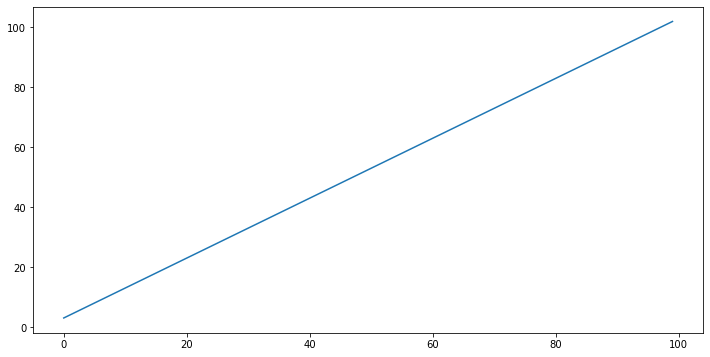

array([  3,   4,   5,   6,   7,   8,   9,  10,  11,  12,  13,  14,  15,
        16,  17,  18,  19,  20,  21,  22,  23,  24,  25,  26,  27,  28,
        29,  30,  31,  32,  33,  34,  35,  36,  37,  38,  39,  40,  41,
        42,  43,  44,  45,  46,  47,  48,  49,  50,  51,  52,  53,  54,
        55,  56,  57,  58,  59,  60,  61,  62,  63,  64,  65,  66,  67,
        68,  69,  70,  71,  72,  73,  74,  75,  76,  77,  78,  79,  80,
        81,  82,  83,  84,  85,  86,  87,  88,  89,  90,  91,  92,  93,
        94,  95,  96,  97,  98,  99, 100, 101, 102])

In [1]:
##line and random points

import numpy as np
import matplotlib.pyplot as plt

line = np.array([i + 3 for i in range(100)])
figure = plt.figure(figsize = (12, 6))
plt.plot(line)
plt.show()
line

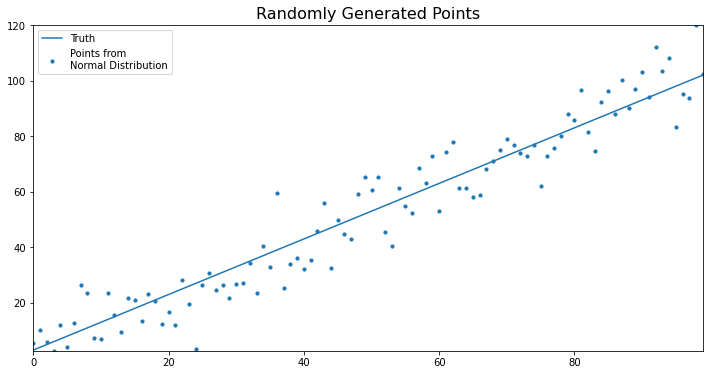

In [2]:
#make array with random points, id-ing mu as mean and sigma as st dev
#create a line with random points along the line
import random

points = []
for point in line:
    points.append(random.normalvariate(point, 10)) #point instead of 10 to not fix st dev

figure = plt.figure(figsize = (12, 6))
plt.rcParams["axes.xmargin"] = 0
plt.rcParams["axes.ymargin"] = 0
#label the line
plt.plot(line, label = "Truth")  
#label the points
plt.scatter(np.arange(len(points)), points, s = 10,   
            label = "Points from\nNormal Distribution")  
#chart title
plt.title("Randomly Generated Points", fontsize = 16)
#add legend
plt.legend(loc="best")  
plt.show()

#points.append(random.normalvariate(mu, sigma))

#st dev is increasing. If you fix the sigma, then the st. dev will be constant, aka the points won't be scattered as much

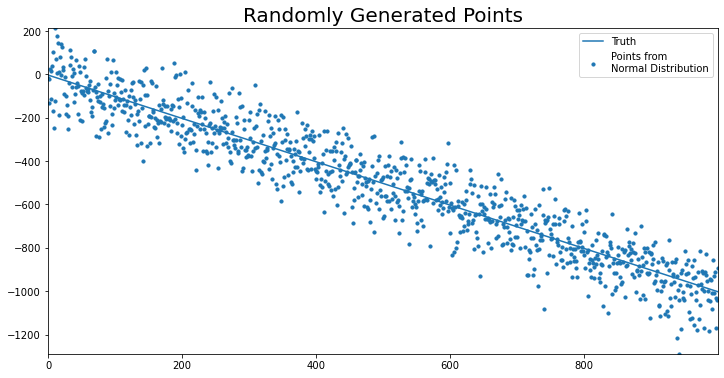

In [3]:
#lineAndRandomPointsFunction.py  
import numpy as np  
import matplotlib.pyplot as plt  
import random  
  
def build_random_data_with_line(y_int, slope, SD = 1, line_length = 100):  
  
    #define line through y int and slope  
    line = np.array([slope * (i + y_int) for i in range(line_length)])  
    points = []  
    for point in line:  
        points.append(random.normalvariate(point, SD))  
          
    return line, points  
  
def plot_line(line, points, line_name = "Truth",   
              title = "Randomly Generated Points"):  
      
    figure = plt.figure(figsize = (12,6))  
    plt.rcParams['axes.ymargin'] = 0  
    plt.rcParams['axes.xmargin'] = 0  
    plt.plot(line, label = line_name)  
    plt.scatter(np.arange(len(points)),points, s = 10,   
                label = "Points from\nNormal Distribution")   
    plt.title(title, fontsize = 20)  
    plt.legend(loc="best")  
    plt.show()  
      
line, points = build_random_data_with_line(y_int = 3, slope = -1, SD = 100, line_length = 1000)  
plot_line(line, points)

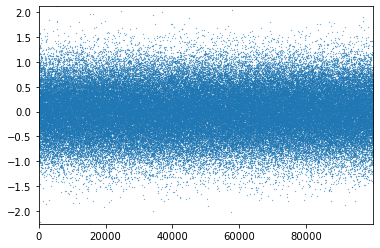

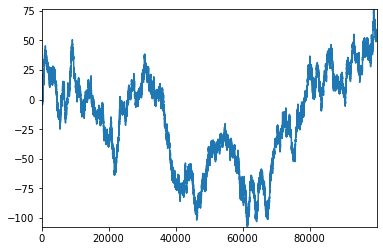

In [4]:
#monte carloSimulation

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import random

mu = 0
# st dev is sigma, variance sigma**2
sigma = .5
random_list = []
observations = 100000
for i in range(100000):
    random_list.append(random.normalvariate(mu,sigma)) #,number = st. dev

plt.plot(random_list, ls = '', marker = '.', markersize = .5)
plt.show()
plt.close()

simulation = []

for i in range(len(random_list)):
    val = random_list[i]
    if i == 0:
        simulation.append(val)
    else:
        simulation.append(simulation[i-1]+val)
        
plt.plot(simulation)
plt.show()
plt.close()

In [5]:
mean = 0
sigma = 1
monte_carlo_sim_dict = {}
num_sims = 2000
periods = 1000
for i in range(num_sims):
    monte_carlo_sim_dict[i] = {}
    for period in range(periods):
        #create variable that reerences sim i in dict
        curr_sim = monte_carlo_sim_dict[i]
        if period == 0:
            curr_sim[period] = random.normalvariate(mean, sigma)
        else:
            curr_sim[period] = curr_sim[period - 1] + random.normalvariate(mean,sigma)
            
monte_carlo_sim_df = pd.DataFrame(monte_carlo_sim_dict)
monte_carlo_sim_df

,0,1,2,3,4,5,6,7,8,9,...,1990,1991,1992,1993,1994,1995,1996,1997,1998,1999
0,-1.209190,-0.785460,-0.453660,0.386243,0.298200,0.984952,0.038116,0.701739,-0.198291,2.132920,...,-1.836463,-0.475991,0.812583,-0.363511,-0.021689,-0.181972,0.275791,-0.763942,-0.424698,0.503239
1,-2.497602,-0.124864,0.254784,1.163728,0.758145,0.576348,0.601405,-0.695082,-0.451687,0.464981,...,-2.797442,-0.599141,-0.882211,-0.639707,-1.233908,0.381409,1.854959,1.638735,0.034408,0.499079
2,-3.046644,-0.267865,-0.270345,0.866748,-0.707894,1.622967,1.584338,-1.077368,-0.472504,-0.723839,...,-3.286697,-0.718412,0.483007,0.828254,-0.117665,0.511671,1.625090,1.897500,-0.149619,1.152137
3,-4.479571,-0.398423,-1.434674,2.109305,-0.933915,1.904006,0.121453,-2.238075,-1.091001,-0.233061,...,-3.836464,-1.724407,1.223705,0.019655,-0.408154,-0.095059,2.637548,0.274921,1.207130,-0.108402
4,-3.740107,0.503567,-3.685887,2.589313,0.980611,3.311866,0.592299,-2.171660,1.418459,0.717967,...,-2.504927,-1.607612,2.473899,-0.698461,-2.075594,1.767049,2.565168,1.935543,1.994270,0.916376
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
995,-37.132955,14.027025,-55.005237,-6.569146,15.749952,-42.001349,-53.070557,-29.794808,51.912905,46.979689,...,7.950483,-1.689718,5.796743,18.331087,-25.286202,-14.605017,7.770402,-3.143851,15.719274,-26.672824
996,-39.404370,14.831033,-54.737124,-5.960892,14.425896,-41.564700,-51.344717,-29.782930,53.083164,44.226035,...,8.436324,-2.421481,8.303339,18.542662,-26.886480,-13.212504,6.892459,-1.800381,15.014557,-26.641002
997,-38.265844,13.979512,-54.583775,-7.432817,12.763429,-42.172349,-51.619687,-30.851452,52.301942,44.350452,...,8.859745,-2.568941,9.172879,20.314395,-27.091557,-13.211877,6.631626,-0.780746,16.171635,-26.178488
998,-36.665578,14.660123,-52.794225,-9.028703,13.615946,-42.082386,-50.825560,-31.770787,50.908297,45.044694,...,9.325409,-2.363573,9.342458,20.836344,-27.331232,-11.649311,7.745229,-1.709571,17.088525,-26.407953


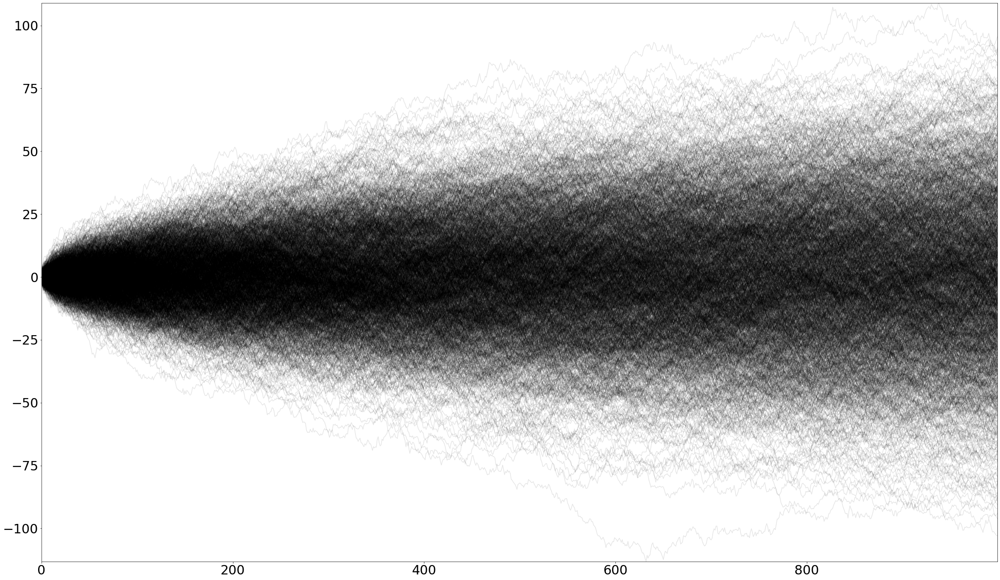

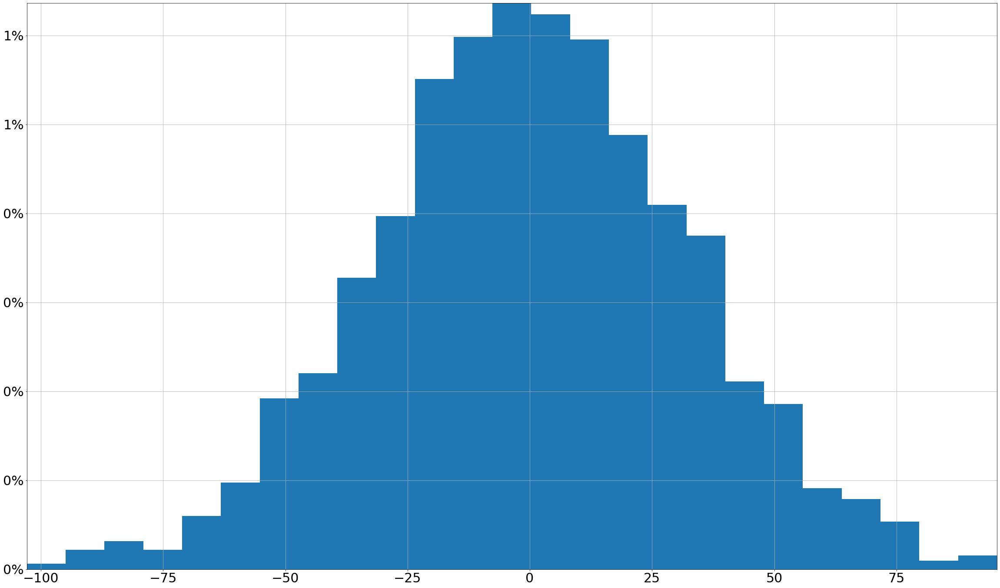

In [6]:
plt.rcParams['axes.xmargin'] = 0
plt.rcParams['axes.ymargin'] = 0
plt.rcParams['font.size'] = 30
fig, ax = plt.subplots(figsize = (40,24))
monte_carlo_sim_df.plot.line(legend = False, marker = '.', markersize = .1,
                            color = 'k', alpha = .1, ax = ax)
plt.show()
plt.close()

fig, ax = plt.subplots(figsize = (40,24))
monte_carlo_sim_df.iloc[-1].hist(bins=25, density = True, ax = ax)

#set vert axis to percent
y_vals = ax.get_yticks()
ax.set_yticklabels([str(int(y * 100)) + '%' for y in y_vals])

plt.show()
plt.close()

### Monte Carlo with a Positive Trend

In [8]:
mean = .05
sigma = .5
monte_carlo_sim_dict = {}
nums_sims = 1000
periods = 1000
for i in range(nums_sims):
    monte_carlo_sim_dict[i] = {}
    for period in range(periods):
        #create var that reference sim i in dict
        curr_sim = monte_carlo_sim_dict[i]
        if period == 0:
            curr_sim[period] = random.normalvariate(mean, sigma)
        else:
            curr_sim[period] = curr_sim[period - 1] + random.normalvariate(mean, sigma)
            
monte_carlo_sim_df = (pd.DataFrame(monte_carlo_sim_dict))

monte_carlo_sim_df

,0,1,2,3,4,5,6,7,8,9,...,990,991,992,993,994,995,996,997,998,999
0,0.830783,-0.416003,0.203112,0.873910,0.375349,-0.845196,0.217752,-0.140261,-0.040625,-0.790831,...,0.419011,0.708824,0.143986,0.215620,0.076729,-0.823676,-0.100386,-0.166996,0.253672,-0.644134
1,1.194715,-0.498487,0.338752,0.986922,1.173196,-0.457705,-0.117817,-0.847649,-0.124290,0.055422,...,1.523268,1.611746,-0.085468,1.174544,-0.715325,-0.128684,0.661345,-0.276577,0.287250,-0.639834
2,0.717317,-0.591261,0.516875,1.097667,0.910611,-0.857631,-0.472370,-0.328424,0.540700,1.453767,...,0.963493,1.531076,0.679570,0.489788,-1.355619,0.465696,0.875350,-0.804761,1.700354,-0.206851
3,1.163261,0.162019,0.874001,0.496358,1.340952,-0.405868,-0.200718,-1.047359,0.611380,1.379897,...,0.983249,1.307630,0.818885,0.132123,-0.842661,0.565634,0.612655,-0.649582,1.723747,-0.760385
4,0.044619,0.490701,0.513448,0.269639,1.602751,-1.051259,0.410401,-1.089982,1.435795,1.820035,...,1.382122,1.571219,-0.075187,0.752792,-0.874035,-0.037835,0.273068,-0.771894,1.762463,-0.953380
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
995,52.914809,46.793803,66.707662,79.603327,47.918536,50.226321,60.074614,39.725919,68.632025,45.251234,...,34.469752,41.837936,37.139265,67.961902,54.864968,42.782139,54.790078,43.117267,41.737067,50.596945
996,52.248384,46.437397,68.096343,79.799403,48.547669,50.372291,60.003549,38.534838,68.982064,45.157277,...,35.124893,42.428995,36.704905,67.814202,55.242033,42.656228,55.456369,42.840567,41.586326,50.977845
997,51.951577,46.173865,68.278037,80.438061,48.149827,50.292757,59.529119,39.006832,68.538745,45.042849,...,35.534339,43.115526,37.119368,67.344947,55.723239,42.975442,55.280964,42.204241,42.200865,51.664945
998,52.370933,45.715698,67.936587,79.876488,47.957916,49.794996,59.649697,39.427007,68.756051,44.739749,...,35.688046,42.469353,37.414210,67.870883,55.769153,43.568679,55.757998,41.428636,41.742125,51.071486


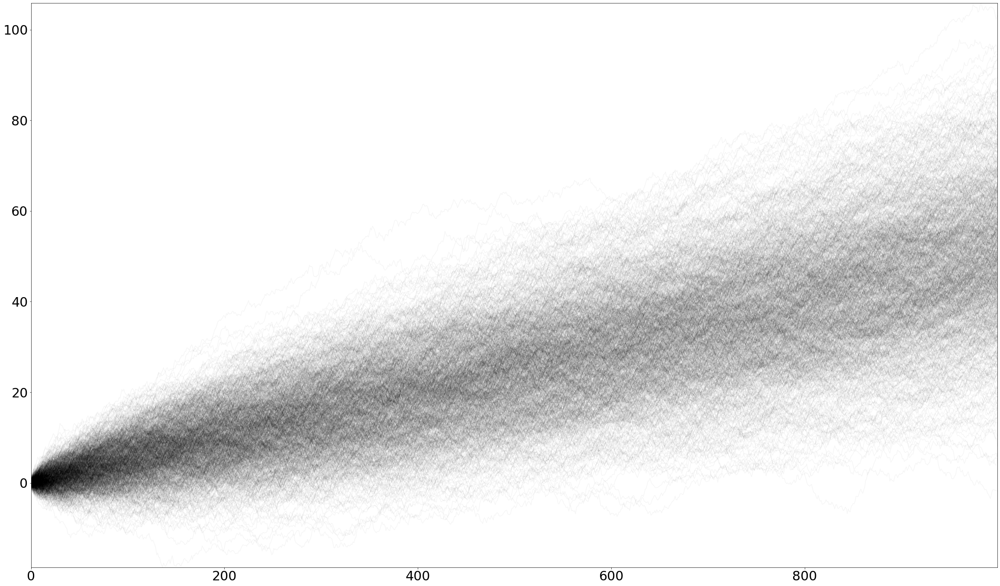

In [10]:
fig, ax = plt.subplots(figsize = (40, 24))
monte_carlo_sim_df.plot.line(legend = False, marker=".", markersize = .1, 
                            color ="k", alpha = .04, ax = ax)

plt.show()

In [11]:
monte_carlo_sim_df["mean"] = monte_carlo_sim_df.mean(axis = 1)
monte_carlo_sim_df["mean"]

0       0.034016
1       0.085985
2       0.142920
3       0.195915
4       0.250448
         ...    
995    50.229687
996    50.257805
997    50.330460
998    50.394755
999    50.425129
Name: mean, Length: 1000, dtype: float64

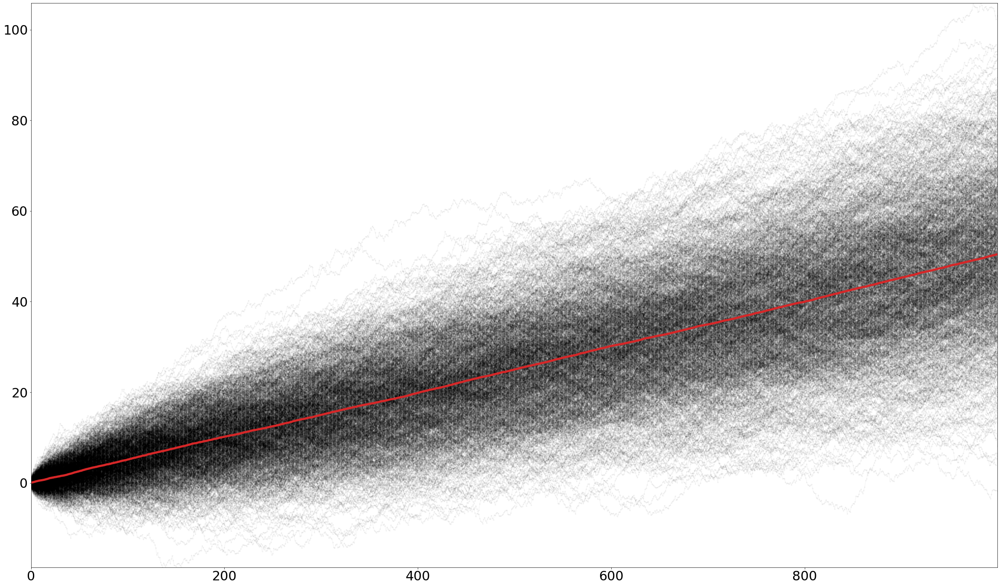

In [12]:
fig, ax = plt.subplots(figsize = (40, 24))
monte_carlo_sim_df.drop("mean", inplace = False, axis = 1).plot.line(legend = False, marker=".", markersize = 5, 
                            color ="k", alpha = .035, ax = ax)
monte_carlo_sim_df["mean"].plot.line(legend = False, color ="C3", linewidth = 5, ax = ax)
plt.show()
plt.close()

### Simulating Changes in Portfolio Values

In [13]:
import pandas_datareader.data as web
import datetime

# date is format (yyyy, mm, dd)
start = datetime.datetime(2005, 1, 1)
end = datetime.datetime.today()

data_dict = {}
stocks = ["MSFT", "AAPL", "IBM", "GOOG"]
for name in stocks:
    # web.DataReader(stockname, source, start_date, end_date)
    data_dict[name] = web.DataReader(name, "yahoo", start, end)
    
    
# make a list of the close data for each stock
close_data_dict = {key:val["Close"] for key, val in data_dict.items()}
close_data_df = pd.DataFrame(close_data_dict)

In [14]:
close_data_pct_change = close_data_df.pct_change()
close_data_pct_change.add(1).fillna(1)

,MSFT,AAPL,IBM,GOOG
Date,,,,
2005-01-03,1.000000,1.000000,1.000000,1.000000
2005-01-04,1.003740,1.010270,0.989258,0.959499
2005-01-05,0.997765,1.008758,0.997932,0.994910
2005-01-06,0.998880,1.000775,0.996891,0.974368
2005-01-07,0.997009,1.072812,0.995634,1.028109
...,...,...,...,...
2020-12-07,0.999673,1.012270,0.980346,0.995345
2020-12-08,1.008027,1.005091,1.008099,0.999489
2020-12-09,0.980510,0.979096,1.008591,0.981073


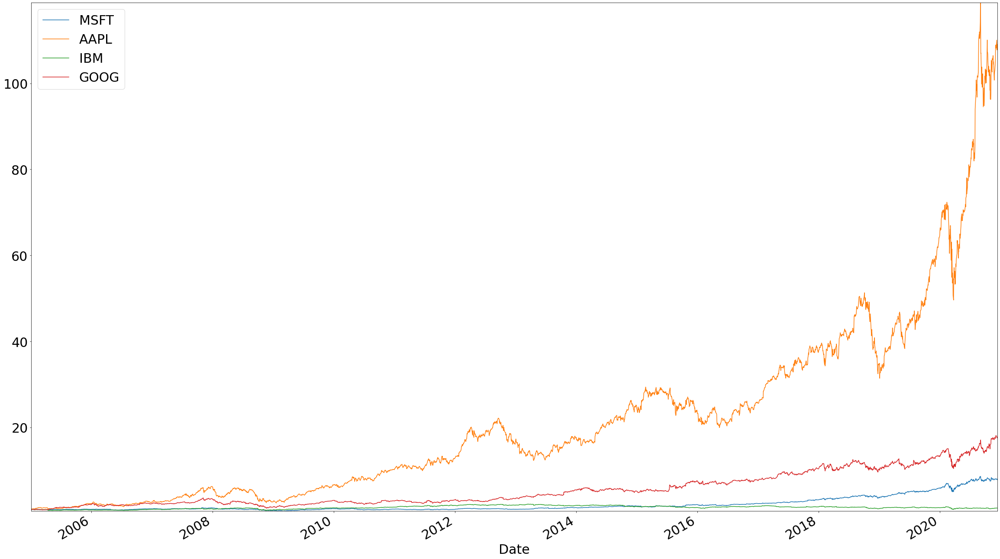

In [15]:
close_data_normalized = close_data_pct_change.add(1).cumprod()
close_data_normalized.fillna(1, inplace = True)
fig, ax = plt.subplots(figsize=(40,24))
close_data_normalized.plot.line(ax=ax)

### Daily Rate of Return

Derive the daily rate of return from the present value equation.

>$PV = \frac{FV}{(1 + r)^t}$

>Overall rate of return: $R=\frac{FV}{PV}$

Discount the overall rate of return to find the average rate of return. We will use this to define the mean of the standard normal distribution:

>$ r = (R)^{\frac{1}{t}} - 1$

>$t$ is measured in days

In [16]:
#from pypfopt import risk_models, expected_returns
mean_var_df = pd.DataFrame({"mean": close_data_normalized.iloc[-1].div(close_data_normalized.iloc[0]) ** (
    1 / close_data_normalized["MSFT"].count()) - 1,
                            "sigma":close_data_pct_change.std()})

mean_var_df

,mean,sigma
MSFT,0.000517,0.017284
AAPL,0.001168,0.021036
IBM,0.000060,0.014579
GOOG,0.000715,0.018819


In [17]:
num_sims = 500
dates = list(close_data_df.index)
monte_carlo_sim_dict = {}
for stock in stocks:
    monte_carlo_sim_dict[stock] = {}
    mean = mean_var_df["mean"][stock]
    sigma = mean_var_df["sigma"][stock] 
    for i in range(num_sims):
        monte_carlo_sim_dict[stock][i] = {}
        curr_sim = monte_carlo_sim_dict[stock][i]

        for date in dates:
            # create variable that references simulation i 
            # in the dictionary
            curr_sim[date] = random.normalvariate(mean, sigma)
            
    monte_carlo_sim_dict[stock] = pd.DataFrame(monte_carlo_sim_dict[stock]).add(1).cumprod()
monte_carlo_sim_dict

{'MSFT':                  0         1         2         3         4          5    \
 2005-01-03  0.989576  0.999273  0.979447  0.996688  1.026964   1.002300   
 2005-01-04  0.977949  1.005735  0.991300  0.980915  1.063172   0.992734   
 2005-01-05  0.985804  1.007891  0.975542  0.989056  1.090964   1.014696   
 2005-01-06  1.010338  0.971388  0.991905  0.992123  1.066296   1.039577   
 2005-01-07  1.028887  0.954270  0.995993  0.993921  1.069305   1.012901   
 ...              ...       ...       ...       ...       ...        ...   
 2020-12-07  2.700543  9.635914  2.430709  0.797662  5.172549  15.304188   
 2020-12-08  2.708544  9.770407  2.439717  0.794861  5.242825  14.852108   
 2020-12-09  2.701700  9.829640  2.434826  0.791506  5.139309  15.208515   
 2020-12-10  2.672771  9.705392  2.436228  0.781315  5.216100  14.904073   
 2020-12-11  2.689672  9.701148  2.357682  0.771345  5.319210  15.284985   
 
                  6         7          8         9    ...       490       491 

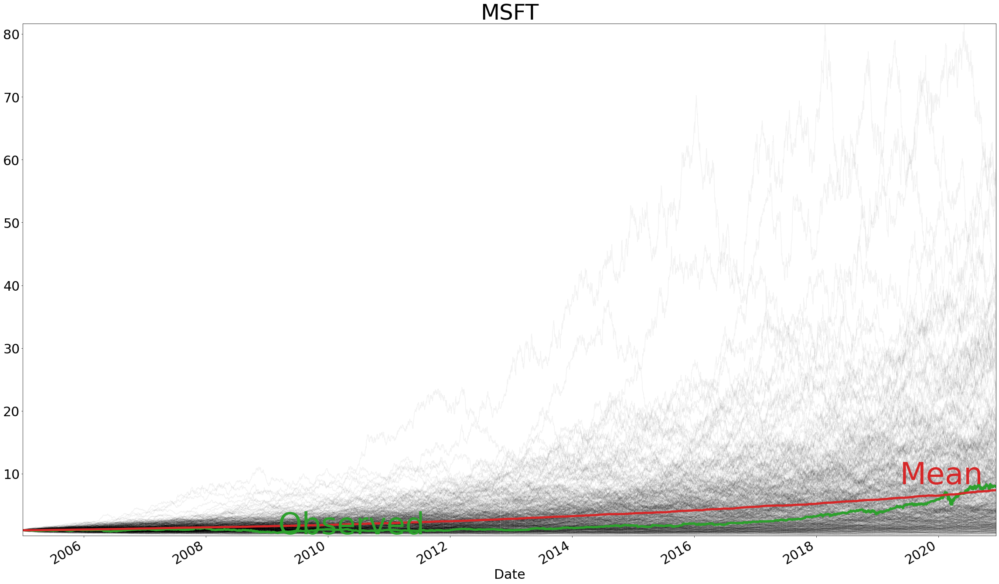

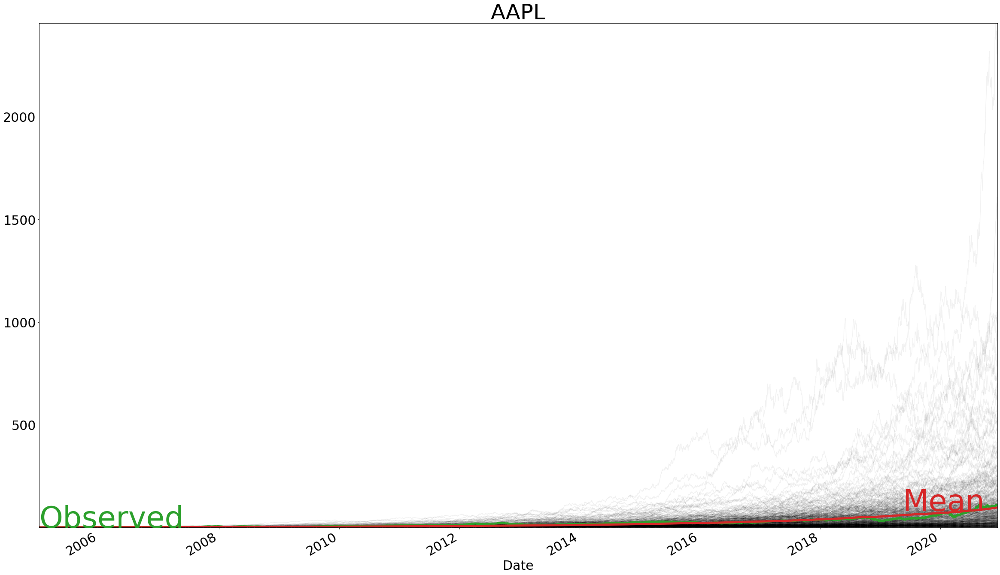

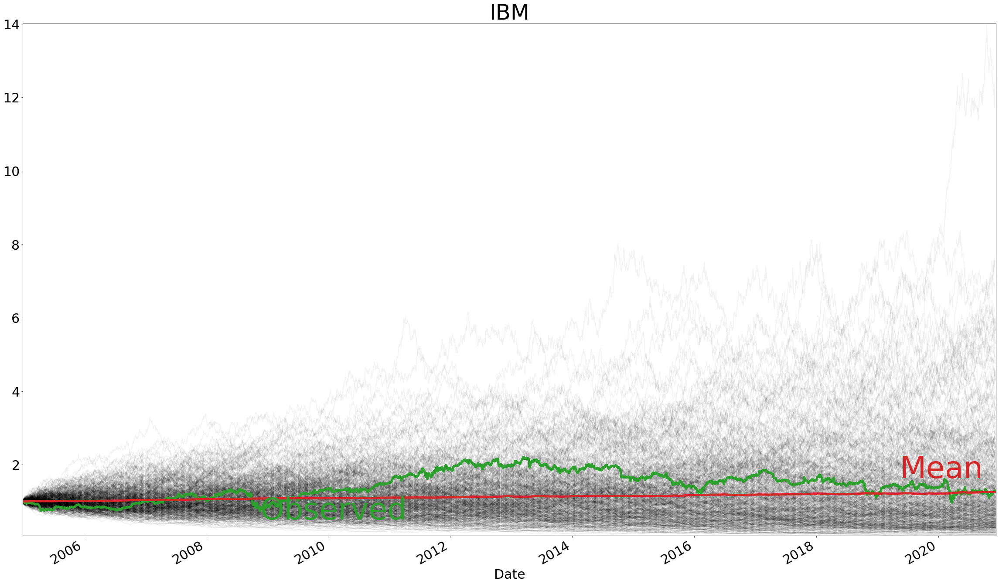

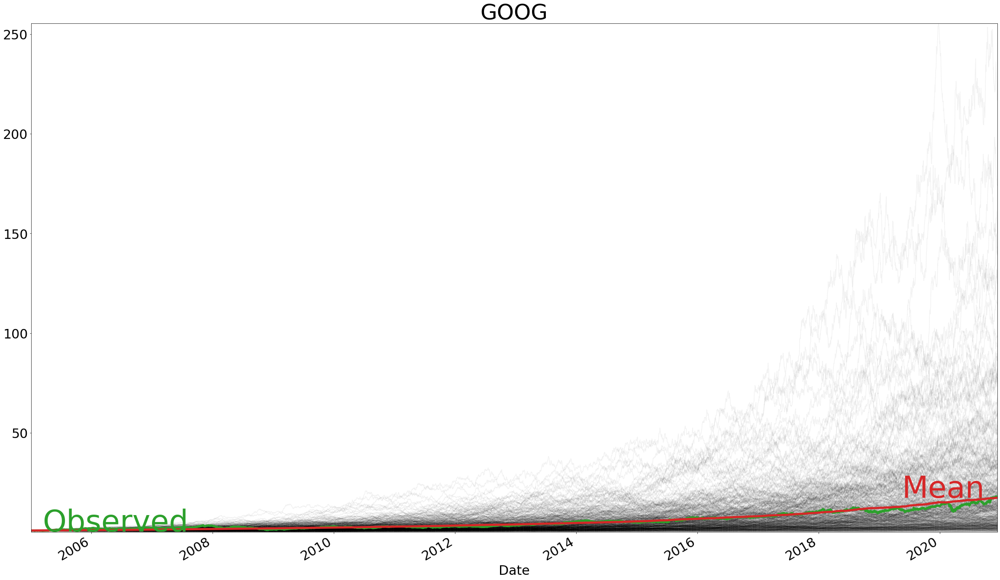

In [19]:
for stock in stocks:
    monte_carlo_sim_dict[stock]["mean"] = monte_carlo_sim_dict[stock].mean(axis=1)
    fig, ax = plt.subplots(figsize = (40, 24))
    monte_carlo_sim_dict[stock].drop("mean", inplace = False, axis = 1).plot.line(legend = False, marker=".", markersize = .1, 
                                color ="k", alpha = .05, ax = ax)
    close_data_normalized[stock].plot.line(legend = False, color ="C2", linewidth = 5, ax = ax, label = "Observed")
    monte_carlo_sim_dict[stock]["mean"].plot.line(legend = False, color ="C3", linewidth = 5, ax = ax)
    
    #find lowest
    obs_text_x = close_data_normalized[close_data_normalized[stock] == close_data_normalized[stock].min()].index
    plt.text(obs_text_x, close_data_normalized[stock].loc[obs_text_x] * .7 , 
         "Observed", fontsize = 70, color = "C2")
    plt.text(dates[-400], monte_carlo_sim_dict[stock]["mean"].iloc[-400] * 1.35 , 
         "Mean", fontsize = 70, color = "C3")
    
    plt.title(stock, fontsize = 50)
    plt.show()
    plt.close()

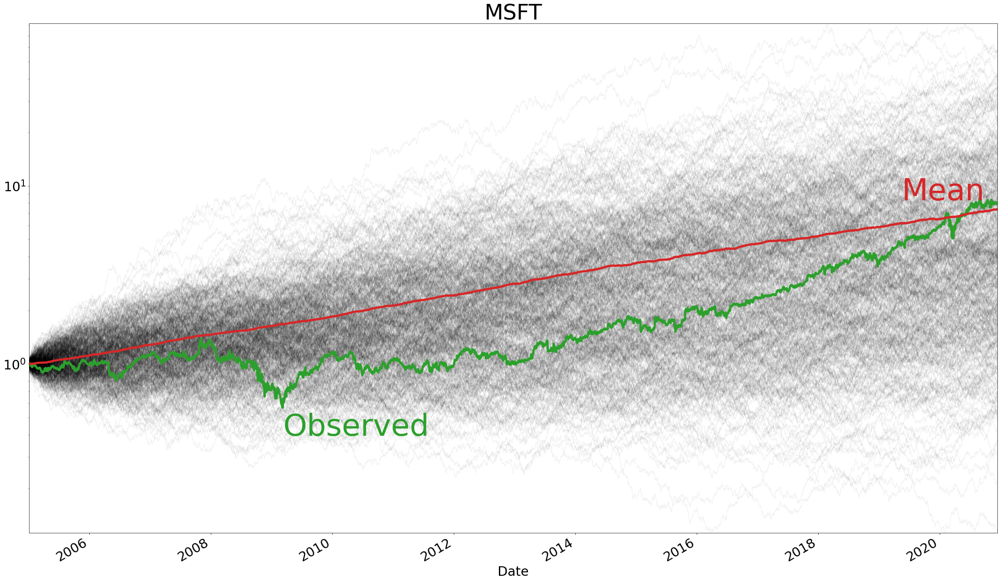

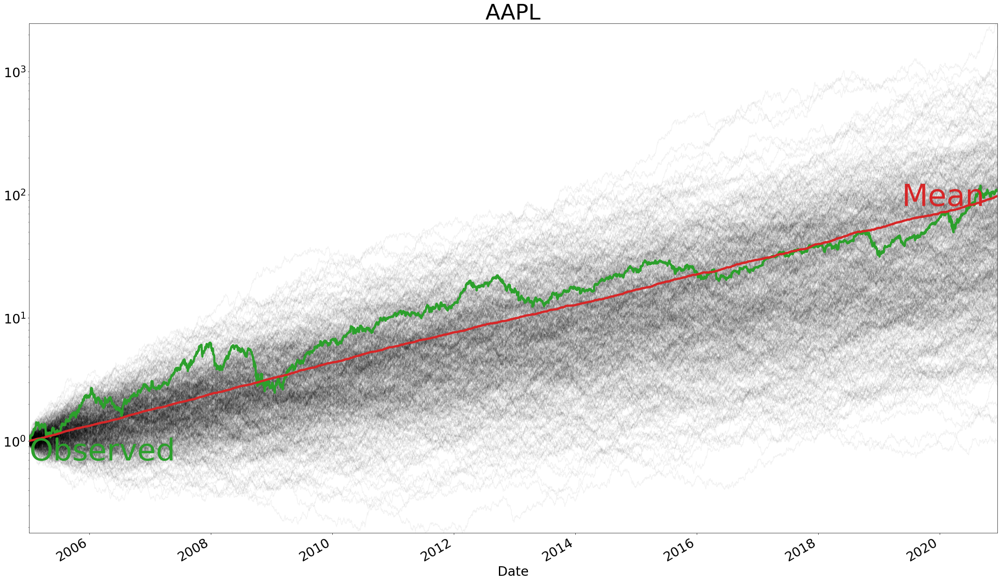

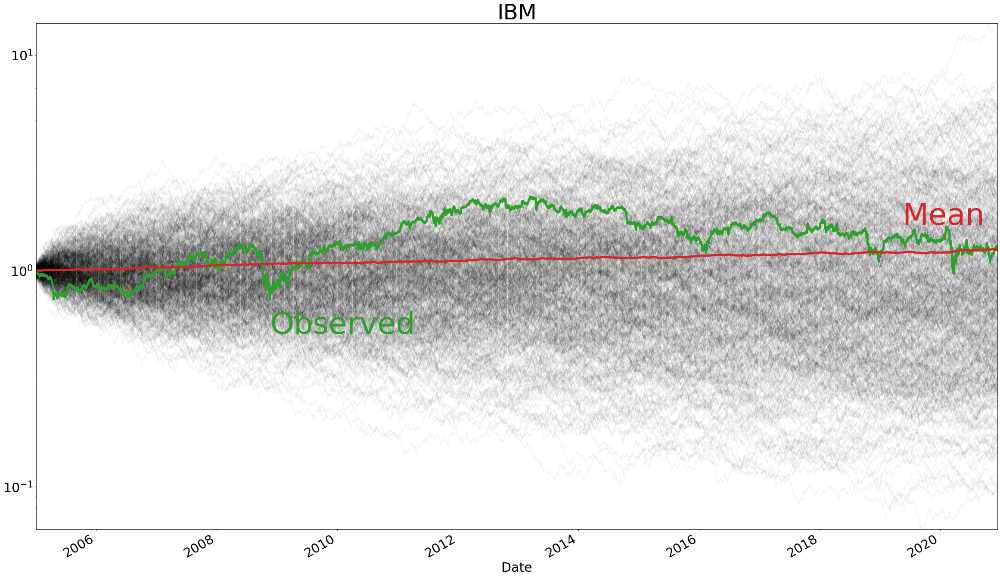

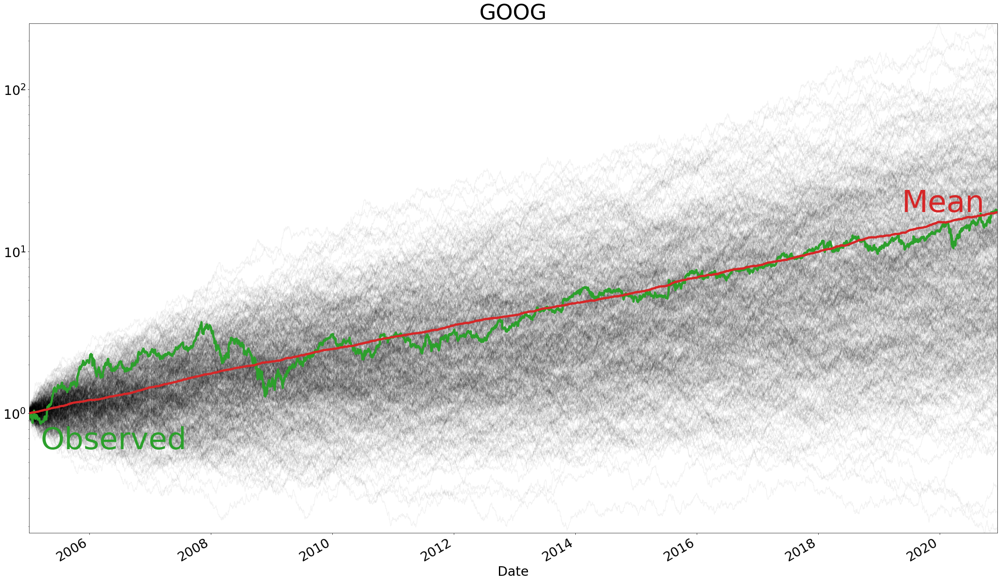

In [20]:
for stock in stocks:
    monte_carlo_sim_dict[stock]["mean"] = monte_carlo_sim_dict[stock].mean(axis=1)
    fig, ax = plt.subplots(figsize = (40, 24))
    monte_carlo_sim_dict[stock].drop("mean", inplace = False, axis = 1).plot.line(legend = False, marker=".", markersize = .1, 
                                color ="k", alpha = .05, logy = True, ax = ax)
    close_data_normalized[stock].plot.line(legend = False, color ="C2", linewidth = 5, logy = True, ax = ax, label = "Observed")
    monte_carlo_sim_dict[stock]["mean"].plot.line(legend = False, color ="C3", linewidth = 5, logy = True, ax = ax)
    
    #find lowest
    obs_text_x = close_data_normalized[close_data_normalized[stock] == close_data_normalized[stock].min()].index
    plt.text(obs_text_x, close_data_normalized[stock].loc[obs_text_x] * .7 , 
         "Observed", fontsize = 70, color = "C2")
    plt.text(dates[-400], monte_carlo_sim_dict[stock]["mean"].iloc[-400] * 1.35 , 
         "Mean", fontsize = 70, color = "C3")
    
    plt.title(stock, fontsize = 50)
    plt.show()
    plt.close()

## Calculate Portfolio Return

In [21]:
portfolio_weights = {stock: 1 / len(stocks) for stock in stocks}
portfolio_weights

{'MSFT': 0.25, 'AAPL': 0.25, 'IBM': 0.25, 'GOOG': 0.25}

In [24]:
ex_return  = pd.DataFrame(close_data_normalized.apply(lambda x: x.mul(portfolio_weights[x.name]), axis = 0).sum(axis = 1), 
                         columns = ["Portfolio Return"])
ex_return

,Portfolio Return
Date,
2005-01-03,1.000000
2005-01-04,0.990692
2005-01-05,0.990610
2005-01-06,0.983643
2005-01-07,1.006923
...,...
2020-12-07,34.201088
2020-12-08,34.356808
2020-12-09,33.659862


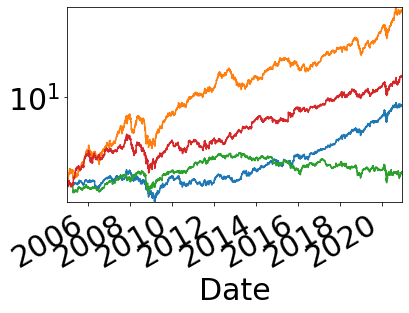

In [25]:
close_data_normalized.plot.line(legend=False, logy = True)

In [26]:
ex_return_pct_change = ex_return.pct_change()
ex_return_pct_change.dropna(inplace = True)
ex_return_pct_change

,Portfolio Return
Date,
2005-01-04,-0.009308
2005-01-05,-0.000082
2005-01-06,-0.007033
2005-01-07,0.023667
2005-01-10,0.001297
...,...
2020-12-07,0.008959
2020-12-08,0.004553
2020-12-09,-0.020286


In [27]:
mean_var_df = pd.DataFrame({"mean": (ex_return.iloc[-1] / ex_return.iloc[0]) ** (1 / ex_return["Portfolio Return"].count()) - 1,
                           "sigma":ex_return_pct_change.std()})
mean_var_df

,mean,sigma
Portfolio Return,0.000877,0.0166


In [28]:
num_sims = 1000
dates = ex_return.index
monte_carlo_sim_dict = {}
mean = mean_var_df["mean"]["Portfolio Return"]
sigma = mean_var_df["sigma"]["Portfolio Return"]


for i in range(num_sims):
    monte_carlo_sim_dict[i] = {}
    curr_sim = monte_carlo_sim_dict[i]
    for date in dates:
        # create variable that references simulation i 
        # in the dictionary
        curr_sim[date] = random.normalvariate(mean, sigma)

monte_carlo_sim_df = pd.DataFrame(monte_carlo_sim_dict).add(1).cumprod()
monte_carlo_sim_df

,0,1,2,3,4,5,6,7,8,9,...,990,991,992,993,994,995,996,997,998,999
2005-01-03,0.997051,0.984176,0.990522,0.978480,1.004619,1.010678,1.000012,1.024731,0.971486,0.990507,...,1.000973,0.994990,1.016387,0.994098,1.007974,0.984855,1.003195,1.009709,0.984478,1.010162
2005-01-04,0.997942,1.015957,0.984137,0.995505,1.008495,1.009658,0.991504,1.023451,0.981270,0.991131,...,1.006328,0.984060,1.027317,0.971668,1.028822,1.018535,0.985214,1.003365,0.984372,1.002023
2005-01-05,0.994456,1.016195,0.987960,1.001884,1.001444,0.979731,0.997147,1.011379,1.014448,1.031974,...,0.986288,0.981270,1.023216,0.991125,1.027574,1.015808,1.013717,0.979382,0.979561,0.995921
2005-01-06,1.004926,1.005660,0.988582,1.016339,1.010049,0.986631,0.972391,1.007391,1.020514,1.013628,...,0.970013,0.986162,1.006178,1.003410,1.015042,0.990598,1.016303,0.964259,0.998176,0.978543
2005-01-07,1.002924,1.007429,0.969599,1.024525,0.999721,0.974248,0.962369,1.020056,1.034549,0.994453,...,0.993417,0.985983,0.984634,1.021729,1.048542,0.988580,0.987540,0.972392,0.976118,0.988455
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2020-12-07,6.179578,127.658302,26.769886,4.956452,24.692057,13.304929,193.632620,18.018720,23.640653,19.257255,...,4.746133,45.769129,8.093699,25.460550,7.247139,31.777855,25.125300,14.873985,2.941875,20.538072
2020-12-08,6.129472,125.989626,26.746670,4.949265,24.929002,13.206621,194.241247,17.911639,24.120876,20.316533,...,4.747291,45.710559,8.336200,25.372643,7.194191,31.046710,25.566572,15.135385,2.887854,20.204397
2020-12-09,5.988463,127.831601,27.010244,5.029207,25.137402,13.215929,189.585671,17.685394,23.750046,20.098409,...,4.711196,45.677500,8.062885,25.655051,7.291721,30.435849,25.805245,15.540729,2.918619,20.429962
2020-12-10,5.951058,130.375083,26.691596,5.181190,25.795996,12.990702,186.908897,18.059672,23.865265,20.120049,...,4.597895,45.727499,8.044330,25.052770,7.430909,31.041923,26.548015,14.723514,2.945731,20.040620


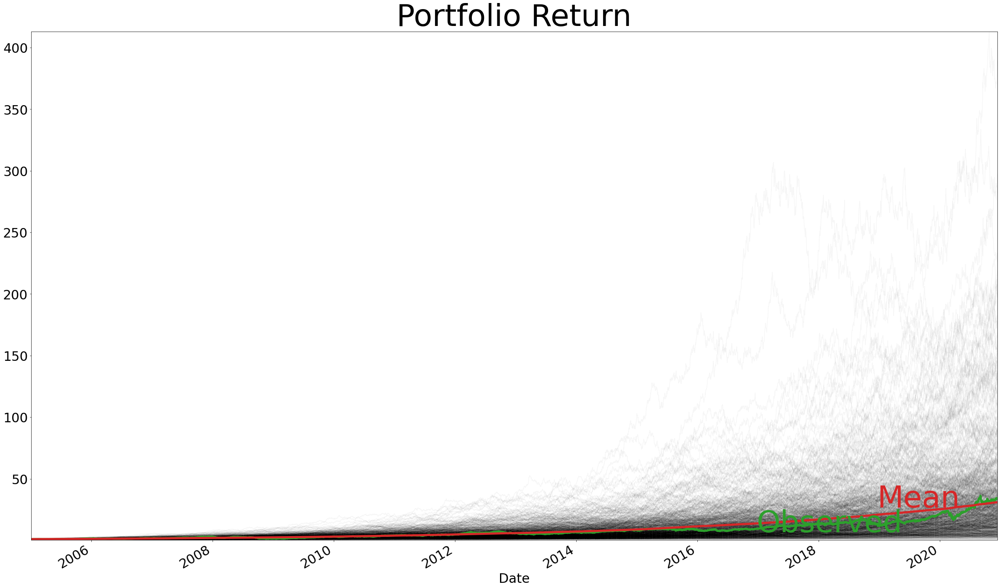

In [31]:
monte_carlo_sim_df["mean"] = monte_carlo_sim_df.mean(axis=1)
fig, ax = plt.subplots(figsize = (40, 24))
monte_carlo_sim_df.drop("mean", inplace = False, axis = 1).plot.line(
                            legend = False, marker=".", markersize = .1, 
                            color ="k", alpha = .035, ax = ax)
ex_return.plot.line(legend = False, color ="C2", linewidth = 5, 
                    ax = ax)
plt.text(dates[-1000], ex_return["Portfolio Return"].iloc[-1000] * .75 , 
         "Observed", fontsize = 70, color = "C2")
monte_carlo_sim_df["mean"].plot.line(legend = False, color ="C3", 
                                     linewidth = 5, 
                                     ax = ax)
plt.text(dates[-500], monte_carlo_sim_df["mean"].iloc[-500] * 1.3, "Mean", 
          fontsize = 70, color = "C3")

plt.title("Portfolio Return", fontsize = 70)
plt.show()
plt.close()

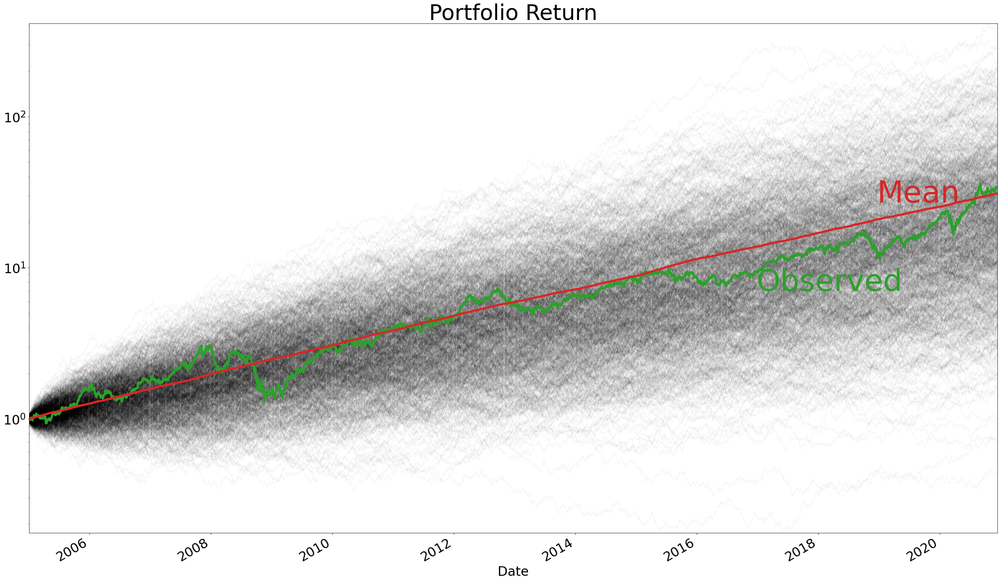

In [32]:
monte_carlo_sim_df["mean"] = monte_carlo_sim_df.mean(axis=1)
fig, ax = plt.subplots(figsize = (40, 24))
monte_carlo_sim_df.drop("mean", inplace = False, axis = 1).plot.line(
                            legend = False, marker=".", markersize = .1, 
                            color ="k", alpha = .035, logy = True, ax = ax)
ex_return.plot.line(legend = False, color ="C2", linewidth = 5, logy = True, 
                    ax = ax)
plt.text(dates[-1000], ex_return["Portfolio Return"].iloc[-1000] * .75 , 
         "Observed", fontsize = 70, color = "C2")
monte_carlo_sim_df["mean"].plot.line(legend = False, color ="C3", 
                                     linewidth = 5, 
                                     logy = True, ax = ax)
plt.text(dates[-500], monte_carlo_sim_df["mean"].iloc[-500] * 1.3, "Mean", 
          fontsize = 70, color = "C3")

plt.title("Portfolio Return", fontsize = 50)
plt.show()
plt.close()

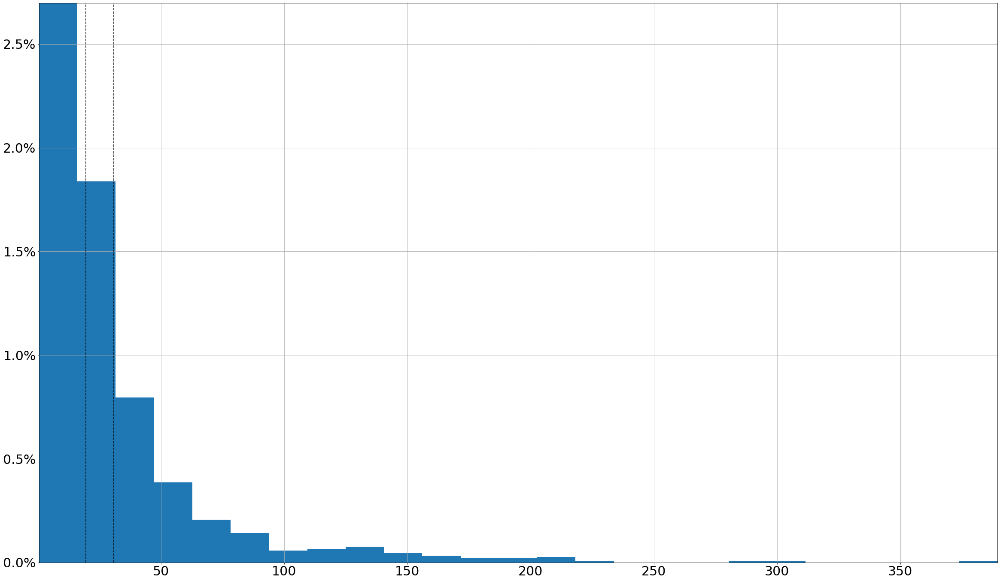

In [33]:
fig, ax = plt.subplots(figsize = (40, 24))
final_vals = monte_carlo_sim_df.iloc[-1]
final_vals.hist(bins = 25, density = True,
                                ax = ax)
ax.axvline(final_vals.median(), ls = "--", color =  "k")
ax.axvline(final_vals["mean"], ls = "--", color =  "k")
# set vertical axis values as percent
y_vals = ax.get_yticks()
ax.set_yticklabels([str(float(y * 100)) + "%" for y in y_vals])
plt.show()
plt.close()